In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
import scipy.stats as st
import seaborn as sb

pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

In [2]:
full = pd.read_csv("SARP WAS 2009-2019.csv", usecols = range(124), nrows = 3136)

In [3]:
def data():
    full = pd.read_csv("SARP WAS 2009-2019.csv", usecols = range(124), nrows = 3136)
    Et = []
    Pe = []
    Bu = []
    Pr = []
    Et = full['EtONO2 (C/D)']/full['Ethane (E)']
    Pe = full['2-PeONO2 (D)']/full['n-Pentane (E)']
    Bu = full['2-BuONO2 (D)']/full['n-Butane (E)']
    Pr = full['i-PrONO2 (D)']/full['Propane (E/B)']
    full['Et ratio'] = Et
    full['Pe ratio'] = Pe
    full['Bu ratio'] = Bu
    full['Pr ratio'] = Pr
    full['Et/Bu ratio'] = Et/Bu
    full['Pr/Bu ratio'] = Pr/Bu
    full['Pe/Bu ratio'] = Pe/Bu
    full = full.replace(np.inf, np.nan)
    return full
    

In [4]:
full = data()

In [5]:
for k in full.keys():
    print(k)

Snake#
Can#
Flight
Jday
date
OpenTime
CloseTime
Julian Open Time
Julian Closing Time
Jopen time Progressive
J close time Progressive
Latitude
Longitude
AltP_feet
AltP_meters
Radaralt_ft
Radaralt_m
SARP Year
Weather
Comments
H2 (ppbv)mult by 1.6
CH4 (ppmv)
CO (ppbv)
CO2_ppm
OCS (MS)
DMS (MS)
CFC-12 (C/D)
CFC-11 (C/D)
CFC-113 (D)
CFC-114 (C/MS)
H-1211 (C/D)
H-1301 (C)
H-2402 (D)
HFC-152a (MS)
HFC-134a (MS)
HCFC-22 (MS)
HCFC-142b
HCFC-141b (MS)
HFC-227ea (MS)
HCFC-124 (MS)
HFC-365mfc (MS)
CHCl3 (C/D)
CH3CCl3 (C/MS)
CCl4 (C/MS)
CH2Cl2 (C/D/MS)
C2HCl3 (D/MS)
C2Cl4 (C/MS)
CH3Cl (MS)
CH3Br (C/MS)
CH3I (C/D)
CH2Br2 (D)
CHBrCl2 (D)
CHBr2Cl (D)
CHBr3 (C/MS)
1,2-DCE (MS)
MeONO2 (C/D)
EtONO2 (C/D)
i-PrONO2 (D)
n-PrONO2 (C)
2-BuONO2 (D)
3-PeONO2 (D)
2-PeONO2 (D)
3-Methyl-2-BuONO2 (D)
Ethane (E)
Ethene (E)
Ethyne (E)
Propane (E/B)
Propene (E)
i-Butane (E)
n-Butane (E)
i-Butene (E)
1-Butene (E)
trans-2-Butene (MS)
cis-2-Butene (MS)
i-Pentane (E)
n-Pentane (E)
1-Pentene
Isoprene (E/B)
1,3-Butadiene (B

In [6]:
def by_year(dataframe, year):
    df = dataframe['SARP Year'].astype(int) == year
    data = dataframe[df]
    return data

In [7]:
def by_alt(dataframe, min_alt, max_alt = 50000):
    altRange = dataframe[(dataframe['AltP_feet'] > min_alt) & (dataframe['AltP_feet'] < max_alt)]
    return altRange

In [8]:
def by_latlong(dataframe, minlat, maxlat, minlong, maxlong):
    data = dataframe[(dataframe['Latitude'] > minlat) & (dataframe['Latitude'] < maxlat) & (dataframe['Longitude'] > minlong) & (dataframe['Longitude'] < maxlong)]
    return data

In [9]:
def by_flight(dataframe, number):
    df = dataframe['Flight'].astype(str) == number
    data = dataframe[df]
    return data

In [10]:
flight_1_2015 = by_flight(by_year(full, 2015), '1')

In [11]:
flight_4_2011 = by_flight(by_year(full, 2011), '4')

In [15]:
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.animation as animation
from celluloid import Camera
ffmpeg = plt.rcParams['animation.ffmpeg_path'] = '/usr/local/bin/ffmpeg'

MovieWriter ffmpeg unavailable.


IndexError: list index out of range

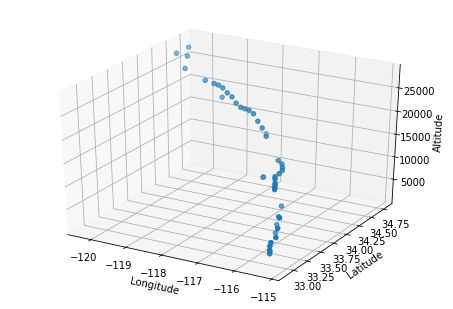

In [16]:
fig = plt.figure()
ax = Axes3D(fig)

def init():
    ax.scatter(flight_1_2015['Longitude'], flight_1_2015['Latitude'], flight_1_2015['AltP_feet'], marker='o')
    ax.set_xlabel('Longitude')
    ax.set_ylabel('Latitude')
    ax.set_zlabel('Altitude')
    return fig

def rotate(angle):
    ax.view_init(azim=angle)
    return fig

#anim = animation.FuncAnimation(fig, animate, init_func=init(),
#                              frames=360, interval=20, blit=True)

angle=3

anim = animation.FuncAnimation(fig, rotate, init_func=init(), frames=np.arange(0, 360, angle), interval=50)

anim.save('3d_2015.gif', writer='ffmpeg', fps=30)

#anim.save?
#anim.save('3d_2015.mp4', fps=30)

MovieWriter ffmpeg unavailable.


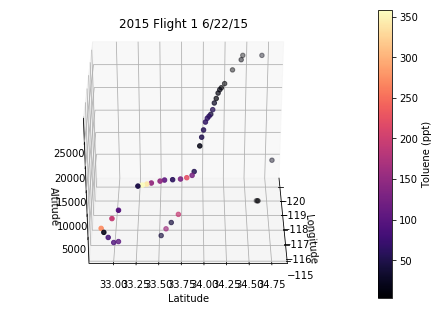

In [17]:
fig = plt.figure()
ax = Axes3D(fig)

def init():
    p = ax.scatter(flight_1_2015['Longitude'], flight_1_2015['Latitude'], flight_1_2015['AltP_feet'], c=flight_1_2015['Toluene (B)'], marker='o', cmap='magma')
    ax.set_xlabel('Longitude')
    ax.set_ylabel('Latitude')
    ax.set_zlabel('Altitude')
    ax.set_title('2015 Flight 1 6/22/15')
    fig.colorbar(p, label='Toluene (ppt)')
    return fig

init = init()

def rotate(angle):
    ax.view_init(azim=angle)
    return fig
angle=3

anim = animation.FuncAnimation(fig, rotate, frames=np.arange(0, 360, angle), interval=50)

anim.save('3d_2015.gif', writer='ffmpeg', fps=10)

MovieWriter ffmpeg unavailable.


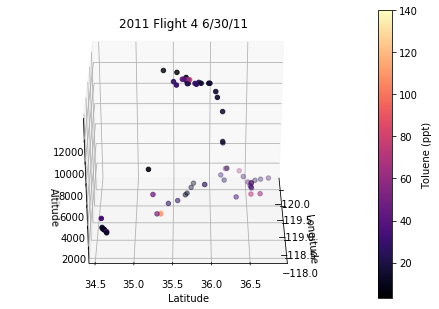

In [61]:
fig = plt.figure()
ax = Axes3D(fig)

def init():
    p = ax.scatter(flight_4_2011['Longitude'], flight_4_2011['Latitude'], flight_4_2011['AltP_feet'], c=flight_4_2011['Toluene (B)'], marker='o', cmap='magma')
    ax.set_xlabel('Longitude')
    ax.set_ylabel('Latitude')
    ax.set_zlabel('Altitude')
    ax.set_title('2011 Flight 4 6/30/11')
    fig.colorbar(p, label = 'Toluene (ppt)')
    return fig

init = init()

def rotate(angle):
    ax.view_init(azim=angle)
    return fig
angle=3

anim = animation.FuncAnimation(fig, rotate, frames=np.arange(0, 360, angle), interval=50)

anim.save('3d_2011.gif', writer='ffmpeg', fps=10)

MovieWriter ffmpeg unavailable.


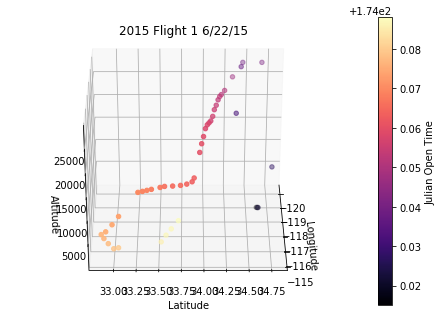

In [66]:
fig = plt.figure()
ax = Axes3D(fig)

def init():
    p = ax.scatter(flight_1_2015['Longitude'], flight_1_2015['Latitude'], flight_1_2015['AltP_feet'], c=flight_1_2015['Julian Open Time'], marker='o', cmap='magma')
    ax.set_xlabel('Longitude')
    ax.set_ylabel('Latitude')
    ax.set_zlabel('Altitude')
    ax.set_title('2015 Flight 1 6/22/15')
    fig.colorbar(p, label = 'Julian Open Time')
    return fig

init = init()

def rotate(angle):
    ax.view_init(azim=angle)
    return fig
angle=3

anim = animation.FuncAnimation(fig, rotate, frames=np.arange(0, 360, angle), interval=50)

anim.save('3d_2015_time.gif', writer='ffmpeg', fps=10)

MovieWriter ffmpeg unavailable.


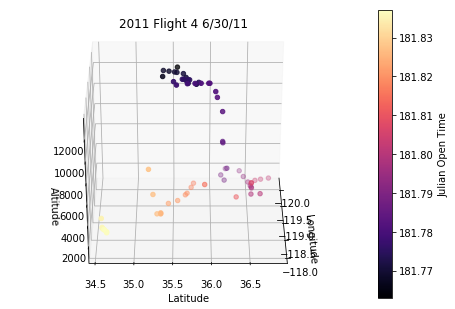

In [62]:
fig = plt.figure()
ax = Axes3D(fig)

def init():
    p = ax.scatter(flight_4_2011['Longitude'], flight_4_2011['Latitude'], flight_4_2011['AltP_feet'], c=flight_4_2011['Julian Open Time'], marker='o', cmap='magma')
    ax.set_xlabel('Longitude')
    ax.set_ylabel('Latitude')
    ax.set_zlabel('Altitude')
    ax.set_title('2011 Flight 4 6/30/11')
    fig.colorbar(p, label = 'Julian Open Time')
    return fig

init = init()

def rotate(angle):
    ax.view_init(azim=angle)
    return fig
angle=3

anim = animation.FuncAnimation(fig, rotate, frames=np.arange(0, 360, angle), interval=50)

anim.save('3d_2011_time.gif', writer='ffmpeg', fps=10)

MovieWriter ffmpeg unavailable.


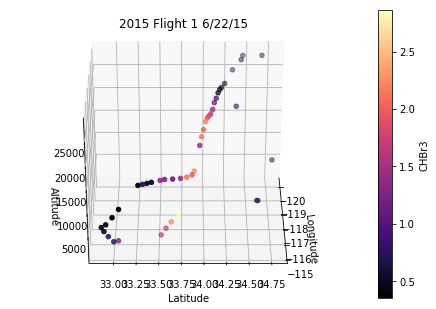

In [67]:
fig = plt.figure()
ax = Axes3D(fig)

def init():
    p = ax.scatter(flight_1_2015['Longitude'], flight_1_2015['Latitude'], flight_1_2015['AltP_feet'], c=flight_1_2015['CHBr3 (C/MS)'], marker='o', cmap='magma')
    ax.set_xlabel('Longitude')
    ax.set_ylabel('Latitude')
    ax.set_zlabel('Altitude')
    ax.set_title('2015 Flight 1 6/22/15')
    fig.colorbar(p, label = 'CHBr3')
    return fig

init = init()

def rotate(angle):
    ax.view_init(azim=angle)
    return fig
angle=3

anim = animation.FuncAnimation(fig, rotate, frames=np.arange(0, 360, angle), interval=50)

anim.save('3d_2015_CHBr3.gif', writer='ffmpeg', fps=10)

MovieWriter ffmpeg unavailable.


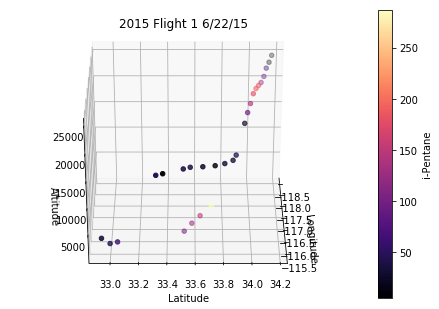

In [68]:
fig = plt.figure()
ax = Axes3D(fig)

def init():
    p = ax.scatter(flight_1_2015['Longitude'], flight_1_2015['Latitude'], flight_1_2015['AltP_feet'], c=flight_1_2015['i-Pentane (E)'], marker='o', cmap='magma')
    ax.set_xlabel('Longitude')
    ax.set_ylabel('Latitude')
    ax.set_zlabel('Altitude')
    ax.set_title('2015 Flight 1 6/22/15')
    fig.colorbar(p, label = 'i-Pentane')
    return fig

init = init()

def rotate(angle):
    ax.view_init(azim=angle)
    return fig
angle=3

anim = animation.FuncAnimation(fig, rotate, frames=np.arange(0, 360, angle), interval=50)

anim.save('3d_2015_pentane.gif', writer='ffmpeg', fps=10)

MovieWriter ffmpeg unavailable.


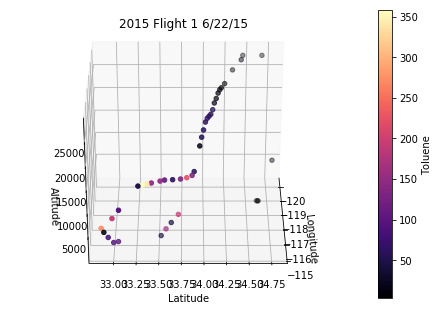

In [69]:
fig = plt.figure()
ax = Axes3D(fig)

def init():
    p = ax.scatter(flight_1_2015['Longitude'], flight_1_2015['Latitude'], flight_1_2015['AltP_feet'], c=flight_1_2015['Toluene (B)'], marker='o', cmap='magma')
    ax.set_xlabel('Longitude')
    ax.set_ylabel('Latitude')
    ax.set_zlabel('Altitude')
    ax.set_title('2015 Flight 1 6/22/15')
    fig.colorbar(p, label = 'Toluene')
    return fig

init = init()

def rotate(angle):
    ax.view_init(azim=angle)
    return fig
angle=3

anim = animation.FuncAnimation(fig, rotate, frames=np.arange(0, 360, angle), interval=50)

anim.save('3d_2015_tol.gif', writer='ffmpeg', fps=10)

MovieWriter ffmpeg unavailable.


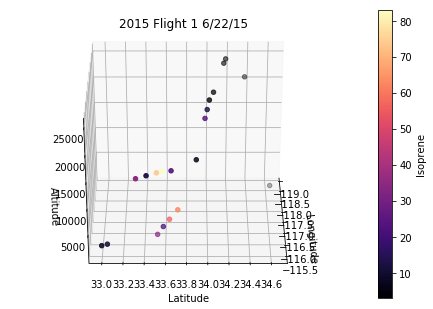

In [70]:
fig = plt.figure()
ax = Axes3D(fig)

def init():
    p = ax.scatter(flight_1_2015['Longitude'], flight_1_2015['Latitude'], flight_1_2015['AltP_feet'], c=flight_1_2015['Isoprene (E/B)'], marker='o', cmap='magma')
    ax.set_xlabel('Longitude')
    ax.set_ylabel('Latitude')
    ax.set_zlabel('Altitude')
    ax.set_title('2015 Flight 1 6/22/15')
    fig.colorbar(p, label = 'Isoprene')
    return fig

init = init()

def rotate(angle):
    ax.view_init(azim=angle)
    return fig
angle=3

anim = animation.FuncAnimation(fig, rotate, frames=np.arange(0, 360, angle), interval=50)

anim.save('3d_2015_isop.gif', writer='ffmpeg', fps=10)

In [18]:
def three_d_cmap(flight, color, filename, title='2015 Flight 1 6/22/15'):
    fig = plt.figure()
    ax = Axes3D(fig)

    def init():
        p = ax.scatter(flight['Longitude'], flight['Latitude'], flight['AltP_feet'], c=flight[color], marker='o', cmap='magma', alpha=0.5)
        ax.set_xlabel('Longitude')
        ax.set_ylabel('Latitude')
        ax.set_zlabel('Altitude')
        ax.set_title(title)
        fig.colorbar(p, label = color)
        return fig

    init = init()

    def rotate(angle):
        ax.view_init(azim=angle)
        return fig
    angle=3

    anim = animation.FuncAnimation(fig, rotate, frames=np.arange(0, 360, angle), interval=50)

    anim.save(filename, writer='ffmpeg', fps=10)

> # 2011

MovieWriter ffmpeg unavailable.


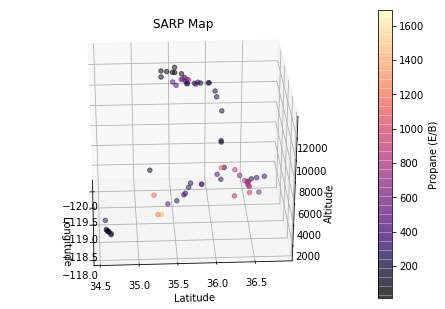

In [21]:
three_d_cmap(flight_4_2011, 'Propane (E/B)', 'Propane_2011_full.gif', title='SARP Map')

MovieWriter ffmpeg unavailable.


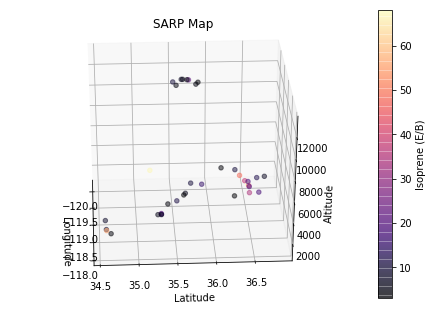

In [22]:
three_d_cmap(flight_4_2011, 'Isoprene (E/B)', 'Isoprene_2011_full.gif', title='SARP Map')

MovieWriter ffmpeg unavailable.


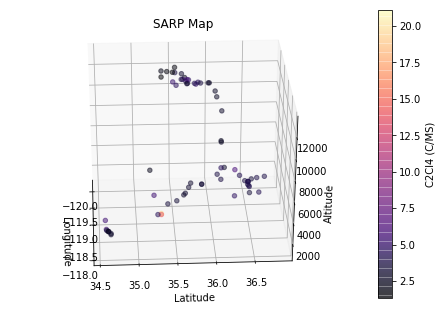

In [23]:
three_d_cmap(flight_4_2011, 'C2Cl4 (C/MS)', 'C2Cl4_2011_full.gif', title='SARP Map')

MovieWriter ffmpeg unavailable.


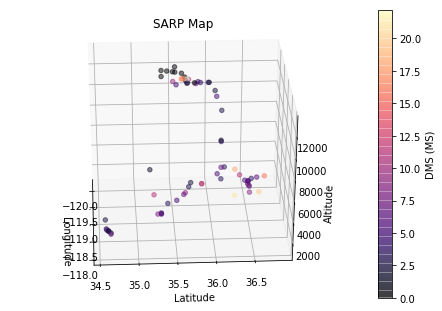

In [24]:
three_d_cmap(flight_4_2011, 'DMS (MS)', 'DMS_2011_full.gif', title='SARP Map')

> # 2015

MovieWriter ffmpeg unavailable.


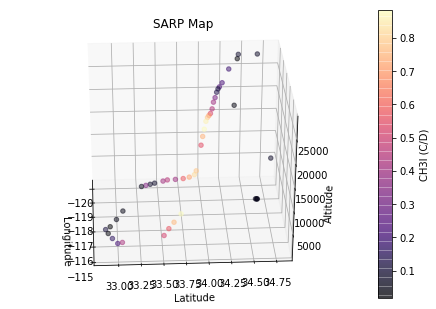

In [102]:
x = by_flight(by_year(full, 2015), '1')
three_d_cmap(x, 'CH3I (C/D)', 'CH3I_2015.gif', title='SARP Map')

MovieWriter ffmpeg unavailable.


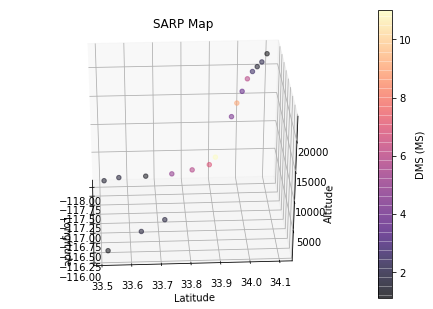

In [104]:
three_d_cmap(x, 'DMS (MS)', 'DMS_2015.gif', title='SARP Map')

In [107]:
y = by_alt(flight_4_2011, 10000)

MovieWriter ffmpeg unavailable.


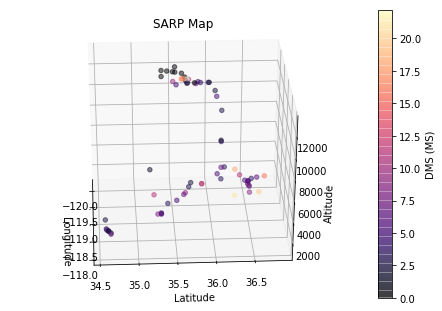

In [119]:
three_d_cmap(flight_4_2011, 'DMS (MS)', 'DMS_2011_full.gif', title='SARP Map')

MovieWriter ffmpeg unavailable.


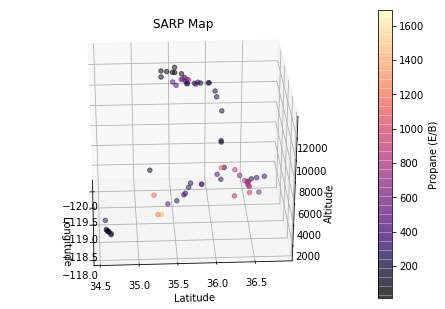

In [120]:
three_d_cmap(flight_4_2011, 'Propane (E/B)', 'Propane_2011_full.gif', title='SARP Map')

MovieWriter ffmpeg unavailable.


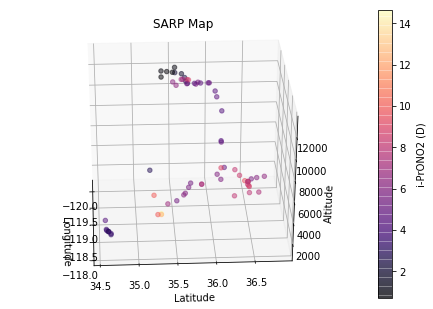

In [121]:
three_d_cmap(flight_4_2011, 'i-PrONO2 (D)', 'i-PrONO2_2011_full.gif', title='SARP Map')

MovieWriter ffmpeg unavailable.


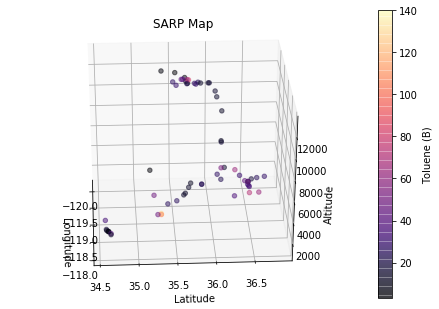

In [122]:
three_d_cmap(flight_4_2011, 'Toluene (B)', 'Toluene_2011_full.gif', title='SARP Map')

MovieWriter ffmpeg unavailable.


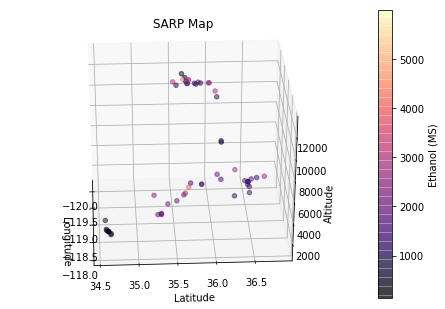

In [123]:
three_d_cmap(flight_4_2011, 'Ethanol (MS)', 'Ethanol_2011_full.gif', title='SARP Map')

MovieWriter ffmpeg unavailable.


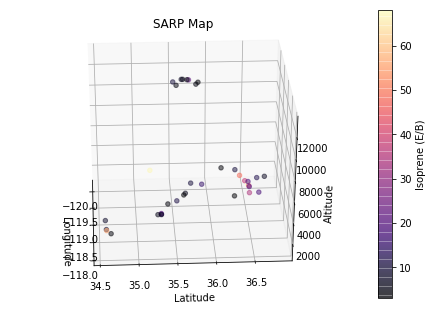

In [124]:
three_d_cmap(flight_4_2011, 'Isoprene (E/B)', 'Isoprene_2011_full.gif', title='SARP Map')

MovieWriter ffmpeg unavailable.


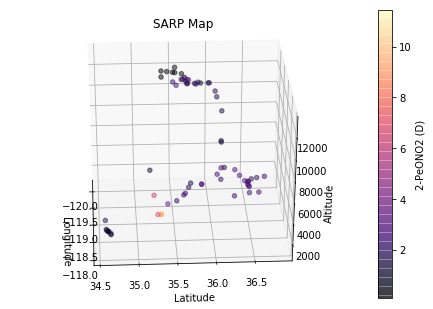

In [117]:
three_d_cmap(flight_4_2011, '2-PeONO2 (D)', '2-PeONO2_2011.gif', title='SARP Map')

MovieWriter ffmpeg unavailable.


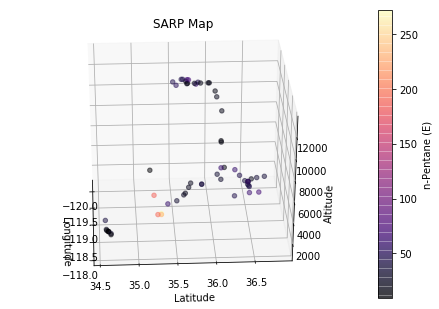

In [118]:
three_d_cmap(flight_4_2011, 'n-Pentane (E)', 'n-Pentane_2011.gif', title='SARP Map')

> ## Plume Aging

In [175]:
two_plumes = by_alt(flight_1_2015, 13000, 26000)

MovieWriter ffmpeg unavailable.


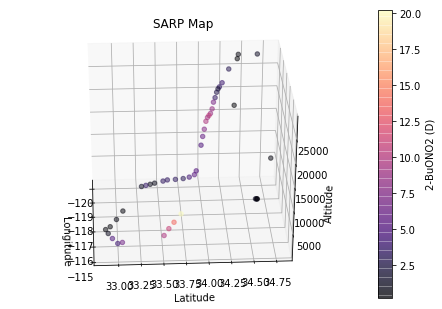

In [178]:
three_d_cmap(flight_1_2015, '2-BuONO2 (D)', '2-BuONO2_2015.gif', 'SARP Map')

MovieWriter ffmpeg unavailable.


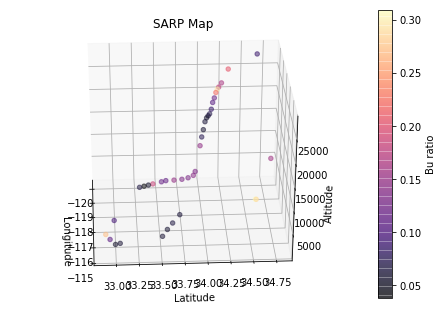

In [181]:
three_d_cmap(flight_1_2015, 'Bu ratio', 'Bu_ratio_2015.gif', 'SARP Map')

MovieWriter ffmpeg unavailable.


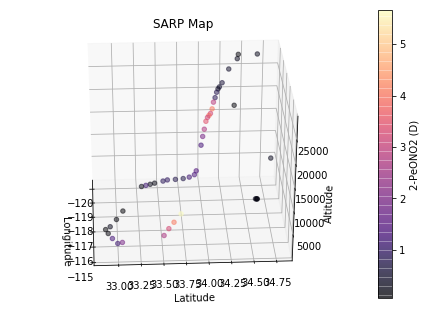

In [173]:
three_d_cmap(flight_1_2015, '2-PeONO2 (D)', '2-PeONO2_2015.gif', 'SARP Map')

MovieWriter ffmpeg unavailable.


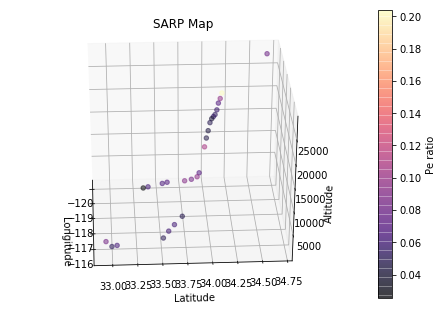

In [180]:
three_d_cmap(flight_1_2015, 'Pe ratio', 'Pe_ratio_2015.gif', 'SARP Map')

MovieWriter ffmpeg unavailable.


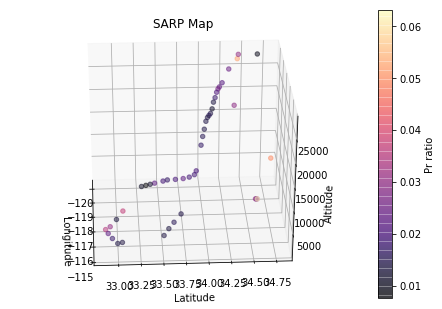

In [185]:
three_d_cmap(flight_1_2015, 'Pr ratio', 'Pr_ratio_2015.gif', 'SARP Map')

MovieWriter ffmpeg unavailable.


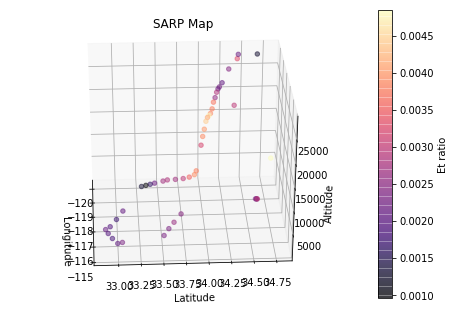

In [157]:
three_d_cmap(flight_1_2015, 'Et ratio', 'Et_ratio_2015.gif', 'SARP Map')

MovieWriter ffmpeg unavailable.


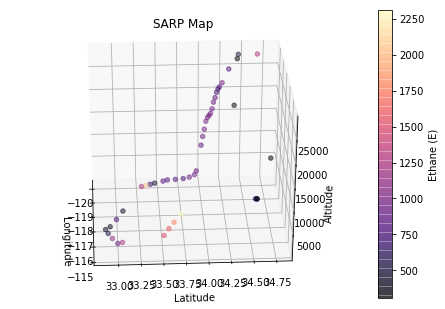

In [159]:
three_d_cmap(flight_1_2015, 'Ethane (E)', 'Ethane_2015.gif', 'SARP Map')

MovieWriter ffmpeg unavailable.


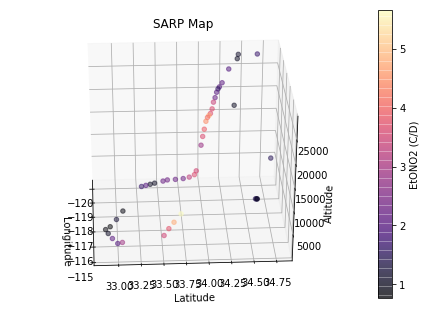

In [161]:
three_d_cmap(flight_1_2015, 'EtONO2 (C/D)', 'EtONO2_2015.gif', 'SARP Map')

MovieWriter ffmpeg unavailable.


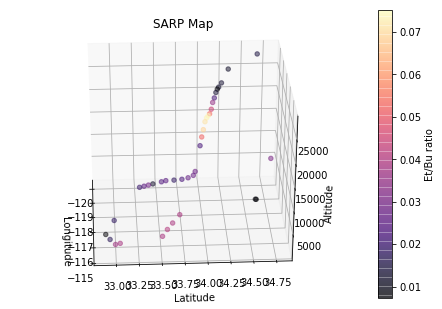

In [197]:
three_d_cmap(flight_1_2015, 'Et/Bu ratio', 'Et.Bu_ratio_2015.gif', 'SARP Map')

MovieWriter ffmpeg unavailable.


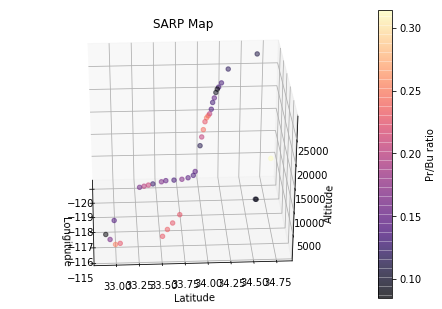

In [198]:
three_d_cmap(flight_1_2015, 'Pr/Bu ratio', 'Pr.Bu_ratio_2015.gif', 'SARP Map')

MovieWriter ffmpeg unavailable.


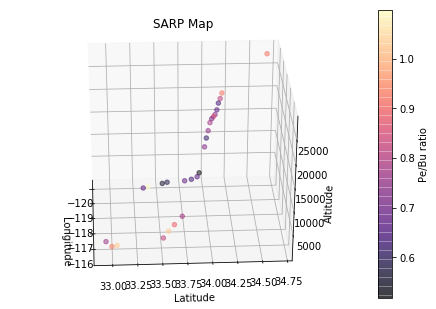

In [253]:
three_d_cmap(flight_1_2015, 'Pe/Bu ratio', 'Pe.Bu_ratio_2015.gif', 'SARP Map')

In [209]:
flight_1_2015

,Snake#,Can#,Flight,Jday,date,OpenTime,CloseTime,Julian Open Time,Julian Closing Time,Jopen time Progressive,J close time Progressive,Latitude,Longitude,AltP_feet,AltP_meters,Radaralt_ft,Radaralt_m,SARP Year,Weather,Comments,H2 (ppbv)mult by 1.6,CH4 (ppmv),CO (ppbv),CO2_ppm,OCS (MS),DMS (MS),CFC-12 (C/D),CFC-11 (C/D),CFC-113 (D),CFC-114 (C/MS),H-1211 (C/D),H-1301 (C),H-2402 (D),HFC-152a (MS),HFC-134a (MS),HCFC-22 (MS),HCFC-142b,HCFC-141b (MS),HFC-227ea (MS),HCFC-124 (MS),HFC-365mfc (MS),CHCl3 (C/D),CH3CCl3 (C/MS),CCl4 (C/MS),CH2Cl2 (C/D/MS),C2HCl3 (D/MS),C2Cl4 (C/MS),CH3Cl (MS),CH3Br (C/MS),CH3I (C/D),CH2Br2 (D),CHBrCl2 (D),CHBr2Cl (D),CHBr3 (C/MS),"1,2-DCE (MS)",MeONO2 (C/D),EtONO2 (C/D),i-PrONO2 (D),n-PrONO2 (C),2-BuONO2 (D),3-PeONO2 (D),2-PeONO2 (D),3-Methyl-2-BuONO2 (D),Ethane (E),Ethene (E),Ethyne (E),Propane (E/B),Propene (E),i-Butane (E),n-Butane (E),i-Butene (E),1-Butene (E),trans-2-Butene (MS),cis-2-Butene (MS),i-Pentane (E),n-Pentane (E),1-Pentene,Isoprene (E/B),"1,3-Butadiene (B)",n-Hexane (E),n-Heptane (E),n-Octane (B),n-Nonane (B),n-Decane (B),"2,2-Dimethylbutane (B)","2,3-Dimethylbutane (MS)",2-Methylpentane (MS),3-Methylpentane (MS),2-Methylhexane (B),3-Methylhexane (B),"2,3-Dimethylpentane (B)","2,4-Dimethylpentane (B)",2-Methylheptane (B),3-Methylheptane (B),"2,2,4-Trimethylpentane (B)",Cyclopentane (B),Methylcyclopentane (B),Cyclohexane (B),Methylcylohexane (B),Benzene (E/MS),Toluene (B),Ethylbenzene (MS),m-Xylene (MS),p-Xylene (MS),m/p-Xylene (MS),o-Xylene (MS),Styrene (MS),i-Propylbenzene (MS),n-Propylbenzene (MS),3-Ethyltoluene (MS),4-Ethyltoluene (MS),2-Ethyltoluene (MS),"1,3,5-Trimethylbenzene (MS)","1,2,4-Trimethylbenzene (MS)","1,2,3-Trimethylbenzene (MS)",alpha-Pinene (MS),beta-Pinene (MS),EtCl (MS),Acetaldehyde (MS),Butanal (MS),Acetone (MS),Butanone (MS),Methanol (MS),Ethanol (MS),Et ratio,Pe ratio,Bu ratio,Pr ratio,Et/Bu ratio,Pr/Bu ratio,Pe/Bu ratio
2582,4101,9354,1,174,6/23/15,0:21:50,0:22:37,174.015,174.016,42178.0152,42178.0157,34.613,-118.074,2537.0,774.0,2537.0,774.0,2015,NaN,NaN,546.0,1.851,63.0,409.0,562,NaN,523.0,235.0,71.4,16.79,3.698,3.42,NaN,9.2,79.5,258.0,24.2,24.6,NaN,1.83,1.22,14.70,3.24,82.7,45.78,0.251,1.173,557.0,7.39,0.052,0.685,0.197,0.153,0.620,8.186,4.699,1.470,1.517,0.487,1.236,0.232,0.326,0.183,582,3.0,78,49.0,NaN,NaN,4.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.0,NaN,NaN,NaN,3.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,13.0,4.0,NaN,NaN,NaN,7.0,3.0,3.0,NaN,4.0,4.0,6.0,4.0,5.0,6.0,9.0,NaN,NaN,NaN,610.0,44.0,1094.0,156.0,749.0,111.0,0.002526,NaN,0.309000,0.030959,0.008174,0.100192,NaN
2583,4116,9346,1,174,6/23/15,0:26:00,0:26:51,174.018,174.019,42178.0181,42178.0186,34.623,-118.072,2517.0,767.0,2517.0,767.0,2015,NaN,NaN,523.0,1.842,66.0,409.0,552,NaN,522.0,236.0,71.7,16.75,3.681,3.41,NaN,10.6,79.5,260.0,24.2,25.2,NaN,1.81,1.31,15.10,3.25,83.2,47.04,0.192,1.280,564.0,7.14,0.069,0.658,0.165,0.109,0.633,9.143,3.289,1.345,1.548,0.368,1.148,0.172,0.192,0.140,647,7.0,94,60.0,4.0,4.0,4.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,30.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,15.0,3.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,339.0,24.0,1304.0,111.0,1084.0,358.0,0.002079,NaN,0.287000,0.025800,0.007243,0.089895,NaN
2584,4117,9350,1,174,6/23/15,0:29:01,0:29:54,174.020,174.021,42178.0202,42178.0208,34.632,-118.073,2508.0,765.0,2508.0,765.0,2015,NaN,NaN,535.0,1.850,65.0,409.0,577,NaN,517.0,233.0,71.2,16.89,3.699,3.25,NaN,11.6,81.6,267.0,24.7,25.9,NaN,2.01,1.22,14.14,3.32,84.1,51.10,0.232,1.351,583.0,7.49,0.054,0.649,0.198,0.147,0.623,9.086,3.487,1.452,1.528,0.490,1.251,0.207,0.264,0.166,632,6.0,94,50.0,11.0,5.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.0,NaN,NaN,18.0,NaN,NaN,NaN,10.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3.0,NaN,NaN,NaN,19.0,5.0,NaN,NaN,NaN,7.0,3.0,3.0,NaN,5.0,4.0,5.0,4.0,6.0,6.0,8.0,NaN,NaN,NaN,605.0,37.0,1664.0,251.0,1091.0,813.0,0.002297,NaN,NaN,0.030560,NaN,NaN,NaN
2585,4102,9356,1,174,6/23/15,0:34:01,0:3

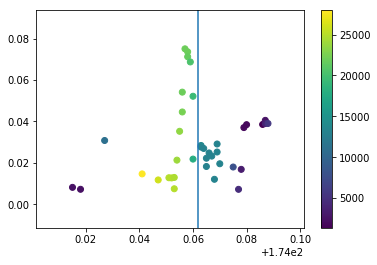

In [236]:
plt.scatter( flight_1_2015['Julian Open Time'], flight_1_2015['Et/Bu ratio'], c=flight_1_2015['AltP_feet'])
plt.axvline(x=174.062)
plt.colorbar()

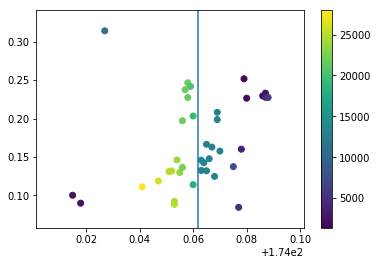

In [244]:
plt.scatter( flight_1_2015['Julian Open Time'], flight_1_2015['Pr/Bu ratio'], c=flight_1_2015['AltP_feet'])
plt.colorbar()
plt.axvline(x=174.062)

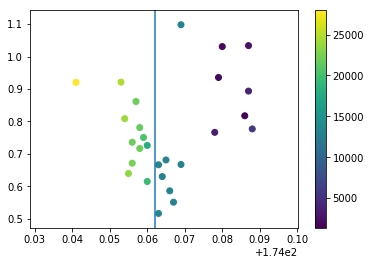

In [245]:
plt.scatter( flight_1_2015['Julian Open Time'], flight_1_2015['Pe/Bu ratio'], c=flight_1_2015['AltP_feet'])
plt.colorbar()
plt.axvline(x=174.062)

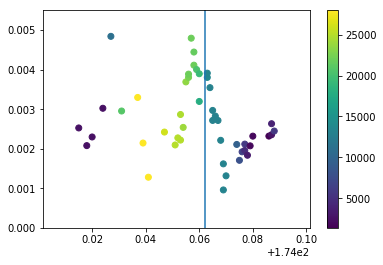

In [246]:
plt.scatter( flight_1_2015['Julian Open Time'], flight_1_2015['Et ratio'], c=flight_1_2015['AltP_feet'])
plt.colorbar()
plt.ylim(0, 0.0055)
plt.axvline(x=174.062)

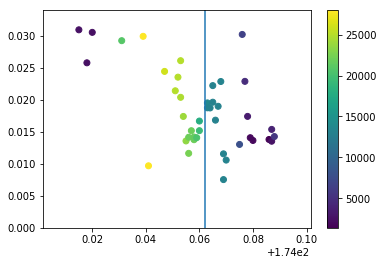

In [247]:
plt.scatter( flight_1_2015['Julian Open Time'], flight_1_2015['Pr ratio'], c=flight_1_2015['AltP_feet'])
plt.colorbar()
plt.ylim(0, 0.034)
plt.axvline(x=174.062)

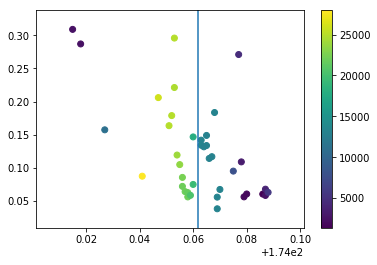

In [248]:
plt.scatter( flight_1_2015['Julian Open Time'], flight_1_2015['Bu ratio'], c=flight_1_2015['AltP_feet'])
plt.colorbar()
plt.axvline(x=174.062)

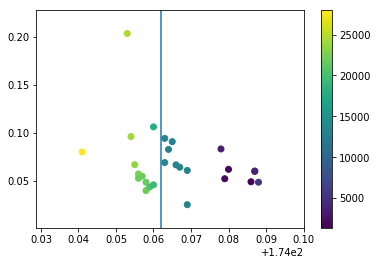

In [249]:
plt.scatter( flight_1_2015['Julian Open Time'], flight_1_2015['Pe ratio'], c=flight_1_2015['AltP_feet'])
plt.colorbar()
plt.axvline(x=174.062)

> # Mapping with BaseMap

In [25]:
pwd

'/Users/joepalmo/Desktop/NASA SARP 2020/WAS code'

In [26]:
import os
import conda

conda_file_dir = conda.__file__
conda_dir = conda_file_dir.split('lib')[0]
proj_lib = os.path.join(os.path.join(conda_dir, 'share'), 'proj')
os.environ["PROJ_LIB"] = proj_lib

from mpl_toolkits.basemap import Basemap

In [27]:
Basemap?

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
MovieWriter ffmpeg unavailable.


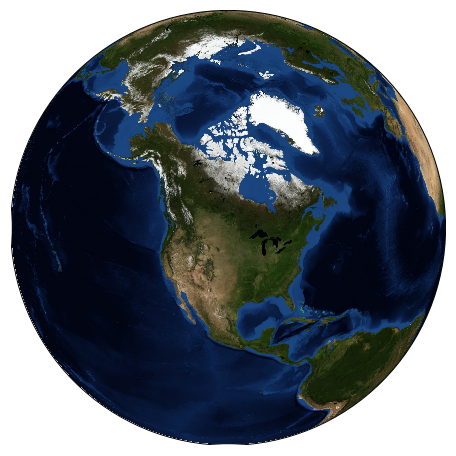

In [62]:
fig = plt.figure(figsize=(8, 8))
def init():
    m = Basemap(projection='ortho', resolution=None, lat_0=50, lon_0=-100)
    m.bluemarble(scale=0.5);
    
init = init()

def rotate(angle):
    ax.view_init(azim=angle)
    return fig
angle=3

anim = animation.FuncAnimation(fig, rotate, frames=np.arange(0, 360, angle), interval=50)

anim.save('earth.gif', writer='ffmpeg', fps=10)

http://server.arcgisonline.com/ArcGIS/rest/services/ESRI_Imagery_World_2D/MapServer/export?bbox=-121.0,32.0,-115.0,38.0&bboxSR=4326&imageSR=4326&size=2000,2000&dpi=96&format=png32&transparent=true&f=image


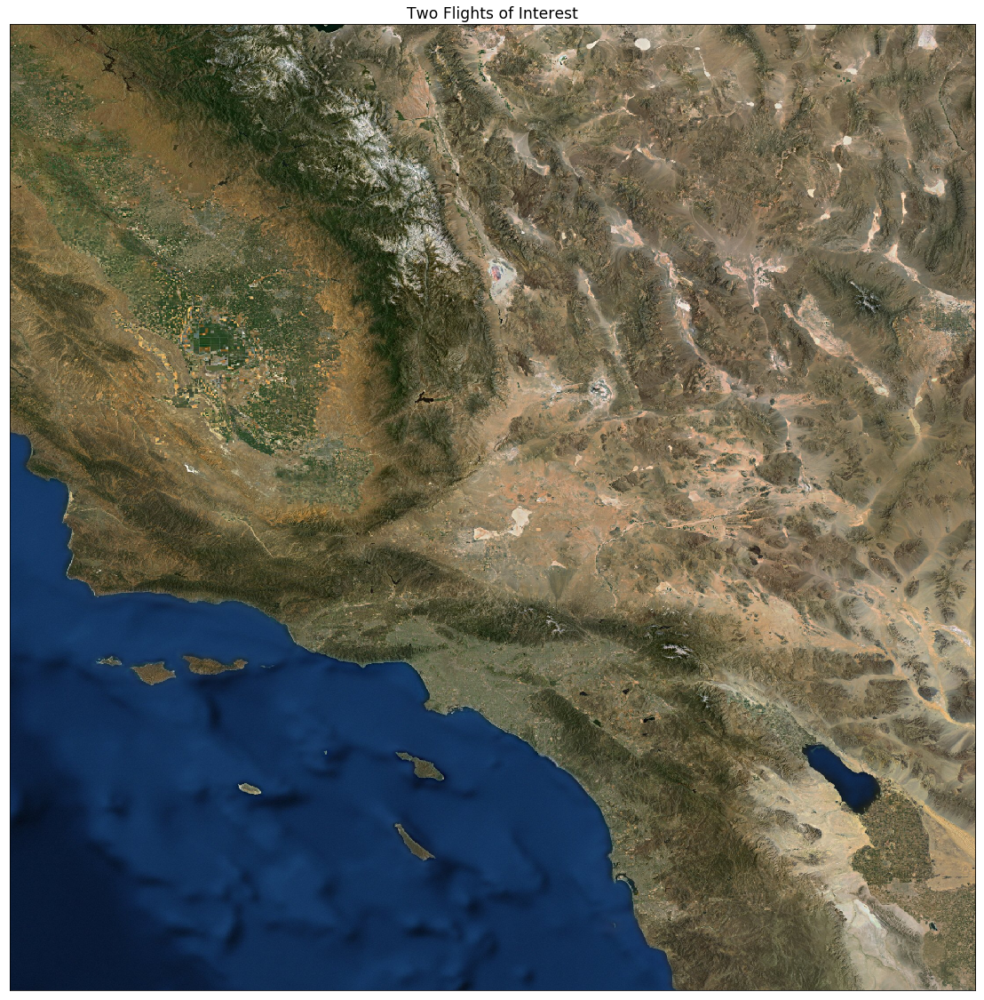

<Figure size 432x288 with 0 Axes>

In [132]:
lats2015 = list(flight_1_2015['Latitude'])
lons2015 = list(flight_1_2015['Longitude'])

lats2011 = list(flight_4_2011['Latitude'])
lons2011 = list(flight_4_2011['Longitude'])

fig = plt.figure(figsize = (20, 20))
m = Basemap(projection='cyl', llcrnrlat=32, llcrnrlon=-121, urcrnrlat=38, urcrnrlon=-115)
x2015,y2015 = m(lons2015, lats2015)
x2011,y2011 = m(lons2011, lats2011)
#m.drawmapboundary(fill_color='#99ffff')
#m.fillcontinents(color='#cc9966',lake_color='#99ffff')
#m.bluemarble()
#m.drawlsmask(land_color='0.8', ocean_color='w', lsmask=None, lsmask_lons=None, lsmask_lats=None, lakes=True, resolution='l', grid=5)
#m.shadedrelief(scale=0.5)
m.arcgisimage(service='ESRI_Imagery_World_2D', xpixels = 2000, verbose= True)
#m.arcgisimage(service='ESRI_StreetMap_World_2D', xpixels = 2000, verbose= True)

#m.scatter?
#m.plot(x,y)

plt.title('Two Flights of Interest',fontsize='xx-large')
#cb = plt.colorbar(plume2015, label = 'Toluene (ppt)')
plt.show()
plt.savefig('bothflights.png', dpi=20)

http://server.arcgisonline.com/ArcGIS/rest/services/ESRI_Imagery_World_2D/MapServer/export?bbox=-121.0,32.0,-115.0,38.0&bboxSR=4326&imageSR=4326&size=2000,2000&dpi=96&format=png32&transparent=true&f=image


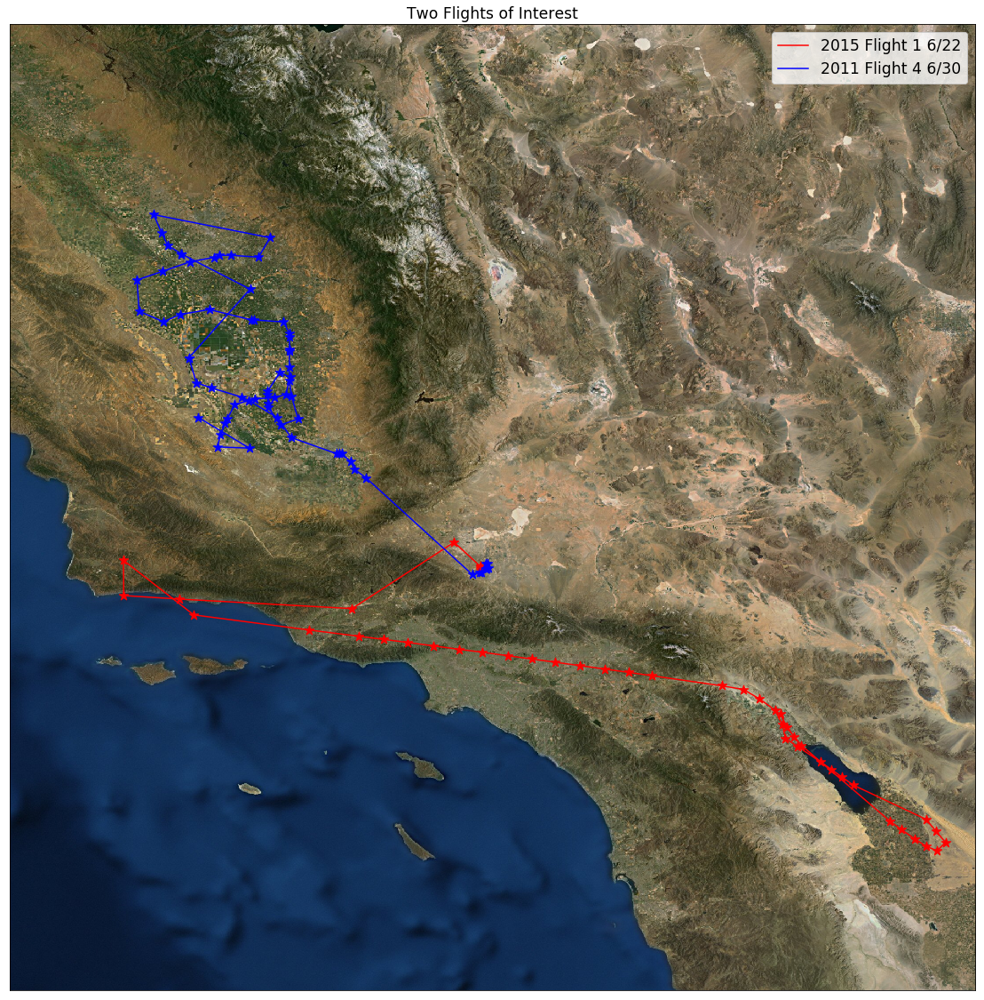

<Figure size 432x288 with 0 Axes>

In [35]:
lats2015 = list(flight_1_2015['Latitude'])
lons2015 = list(flight_1_2015['Longitude'])

lats2011 = list(flight_4_2011['Latitude'])
lons2011 = list(flight_4_2011['Longitude'])

fig = plt.figure(figsize = (20, 20))
m = Basemap(projection='cyl', llcrnrlat=32, llcrnrlon=-121, urcrnrlat=38, urcrnrlon=-115)
x2015,y2015 = m(lons2015, lats2015)
x2011,y2011 = m(lons2011, lats2011)
#m.drawmapboundary(fill_color='#99ffff')
#m.fillcontinents(color='#cc9966',lake_color='#99ffff')
#m.bluemarble()
#m.drawlsmask(land_color='0.8', ocean_color='w', lsmask=None, lsmask_lons=None, lsmask_lats=None, lakes=True, resolution='l', grid=5)
#m.shadedrelief(scale=0.5)
m.arcgisimage(service='ESRI_Imagery_World_2D', xpixels = 2000, verbose= True)
#m.arcgisimage(service='ESRI_StreetMap_World_2D', xpixels = 2000, verbose= True)

plt.plot(x2015,y2015, color='red', label='2015 Flight 1 6/22')
plume2015 = plt.scatter(x2015,y2015,s=120, marker='*', color='red', cmap='magma')
plt.plot(x2011,y2011, color='blue',label='2011 Flight 4 6/30')
plume2011 = plt.scatter(x2011,y2011,s=120, marker='*', color='blue')
#m.scatter?
#m.plot(x,y)

plt.title('Two Flights of Interest',fontsize='xx-large')
plt.legend(fontsize='xx-large')
#cb = plt.colorbar(plume2015, label = 'Toluene (ppt)')
plt.show()
plt.savefig('bothflights.png', dpi=20)

In [39]:
flight_4_2011

,Snake#,Can#,Flight,Jday,date,OpenTime,CloseTime,Julian Open Time,Julian Closing Time,Jopen time Progressive,J close time Progressive,Latitude,Longitude,AltP_feet,AltP_meters,Radaralt_ft,Radaralt_m,SARP Year,Weather,Comments,H2 (ppbv)mult by 1.6,CH4 (ppmv),CO (ppbv),CO2_ppm,OCS (MS),DMS (MS),CFC-12 (C/D),CFC-11 (C/D),CFC-113 (D),CFC-114 (C/MS),H-1211 (C/D),H-1301 (C),H-2402 (D),HFC-152a (MS),HFC-134a (MS),HCFC-22 (MS),HCFC-142b,HCFC-141b (MS),HFC-227ea (MS),HCFC-124 (MS),HFC-365mfc (MS),CHCl3 (C/D),CH3CCl3 (C/MS),CCl4 (C/MS),CH2Cl2 (C/D/MS),C2HCl3 (D/MS),C2Cl4 (C/MS),CH3Cl (MS),CH3Br (C/MS),CH3I (C/D),CH2Br2 (D),CHBrCl2 (D),CHBr2Cl (D),CHBr3 (C/MS),"1,2-DCE (MS)",MeONO2 (C/D),EtONO2 (C/D),i-PrONO2 (D),n-PrONO2 (C),2-BuONO2 (D),3-PeONO2 (D),2-PeONO2 (D),3-Methyl-2-BuONO2 (D),Ethane (E),Ethene (E),Ethyne (E),Propane (E/B),Propene (E),i-Butane (E),n-Butane (E),i-Butene (E),1-Butene (E),trans-2-Butene (MS),cis-2-Butene (MS),i-Pentane (E),n-Pentane (E),1-Pentene,Isoprene (E/B),"1,3-Butadiene (B)",n-Hexane (E),n-Heptane (E),n-Octane (B),n-Nonane (B),n-Decane (B),"2,2-Dimethylbutane (B)","2,3-Dimethylbutane (MS)",2-Methylpentane (MS),3-Methylpentane (MS),2-Methylhexane (B),3-Methylhexane (B),"2,3-Dimethylpentane (B)","2,4-Dimethylpentane (B)",2-Methylheptane (B),3-Methylheptane (B),"2,2,4-Trimethylpentane (B)",Cyclopentane (B),Methylcyclopentane (B),Cyclohexane (B),Methylcylohexane (B),Benzene (E/MS),Toluene (B),Ethylbenzene (MS),m-Xylene (MS),p-Xylene (MS),m/p-Xylene (MS),o-Xylene (MS),Styrene (MS),i-Propylbenzene (MS),n-Propylbenzene (MS),3-Ethyltoluene (MS),4-Ethyltoluene (MS),2-Ethyltoluene (MS),"1,3,5-Trimethylbenzene (MS)","1,2,4-Trimethylbenzene (MS)","1,2,3-Trimethylbenzene (MS)",alpha-Pinene (MS),beta-Pinene (MS),EtCl (MS),Acetaldehyde (MS),Butanal (MS),Acetone (MS),Butanone (MS),Methanol (MS),Ethanol (MS),Et ratio,Pe ratio,Bu ratio,Pr ratio,Et/Bu ratio,Pr/Bu ratio,Pe/Bu ratio
1511,2101,8137,4,181,6/30/11,18:19:11,18:19:33,181.763,181.764,40724.7633,40724.7636,35.558328,-119.827254,13041.0,NaN,NaN,12806.5,2011,NaN,NaN,NaN,1.804,83.0,NaN,530,0.0,545.0,244.0,75.3,16.7,4.43,3.310,NaN,NaN,60.5,234.0,23.1,23.3,NaN,NaN,NaN,11.40,6.80,86.87,26.18,0.11,1.769,535.0,7.04,0.070,0.585,0.126,0.05,0.24,9.900,2.35,0.77,0.99,0.19,0.47,0.10,0.39,0.05,385,8.0,36,22.0,10.0,NaN,NaN,6.0,NaN,NaN,NaN,6.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5.0,5.0,NaN,NaN,NaN,NaN,16.0,10.0,NaN,NaN,17.0,20.0,NaN,NaN,3.0,11.0,NaN,7.0,NaN,NaN,8.0,3.0,11.0,4.0,NaN,NaN,NaN,4.0,5.0,5.0,4.0,5.0,11.0,NaN,NaN,NaN,58.0,NaN,210.0,NaN,NaN,NaN,0.002000,NaN,NaN,0.045000,NaN,NaN,NaN
1512,2116,5150,4,181,6/30/11,18:23:58,18:24:15,181.767,181.767,40724.7666,40724.7668,35.367365,-119.509409,13045.0,NaN,NaN,13235.0,2011,NaN,NaN,NaN,1.801,82.0,NaN,523,0.0,547.0,247.0,76.7,16.7,4.39,3.300,NaN,NaN,62.1,237.0,24.1,23.3,NaN,NaN,NaN,NaN,7.06,87.16,32.33,0.10,1.308,545.0,7.07,0.080,0.608,0.133,0.05,0.21,9.636,2.27,0.49,0.71,0.06,0.32,0.07,0.10,0.18,373,11.0,32,16.0,9.0,NaN,NaN,4.0,NaN,NaN,NaN,8.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,14.0,8.0,NaN,NaN,6.0,NaN,NaN,5.0,7.0,NaN,NaN,7.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,70.0,NaN,473.0,NaN,NaN,NaN,0.001314,NaN,NaN,0.044375,NaN,NaN,NaN
1513,2117,6231,4,181,6/30/11,18:26:44,18:27:06,181.769,181.769,40724.7686,40724.7688,35.374602,-119.709437,13051.0,NaN,NaN,12734.0,2011,NaN,NaN,NaN,1.798,82.0,NaN,522,0.0,560.0,253.0,79.5,16.7,4.32,3.440,NaN,NaN,62.8,240.0,23.6,23.9,NaN,NaN,NaN,NaN,6.58,85.03,25.97,0.17,2.077,554.0,7.42,0.120,0.601,0.175,0.07,0.24,8.448,2.18,0.74,0.96,0.12,0.52,0.11,0.12,0.22,433,22.0,53,32.0,12.0,NaN,NaN,11.0,NaN,NaN,NaN,6.0,NaN,NaN,NaN,NaN,NaN,NaN,6.0,17.0,5.0,NaN,NaN,NaN,NaN,8.0,18.0,NaN,NaN,4.0,NaN,NaN,NaN,4.0,NaN,NaN,11.0,6.0,NaN,5.0,4.0,9.0,3.0,NaN,NaN,NaN,3.0,NaN,4.0,4.0,7.0,9.0,NaN,NaN,NaN,114.0,NaN,437.0,NaN,NaN,NaN,0.001709,NaN,NaN,0.030000,NaN,NaN,NaN
1514,2102,8138,4,181,6/30/11,18:27:21,18:27:39,181.769,181.769,40724.7690,40724.7692,35.448714,-119.687781,13046.0,NaN,NaN,13047

http://server.arcgisonline.com/ArcGIS/rest/services/ESRI_Imagery_World_2D/MapServer/export?bbox=-121.0,32.0,-115.0,38.0&bboxSR=4326&imageSR=4326&size=2000,2000&dpi=96&format=png32&transparent=true&f=image


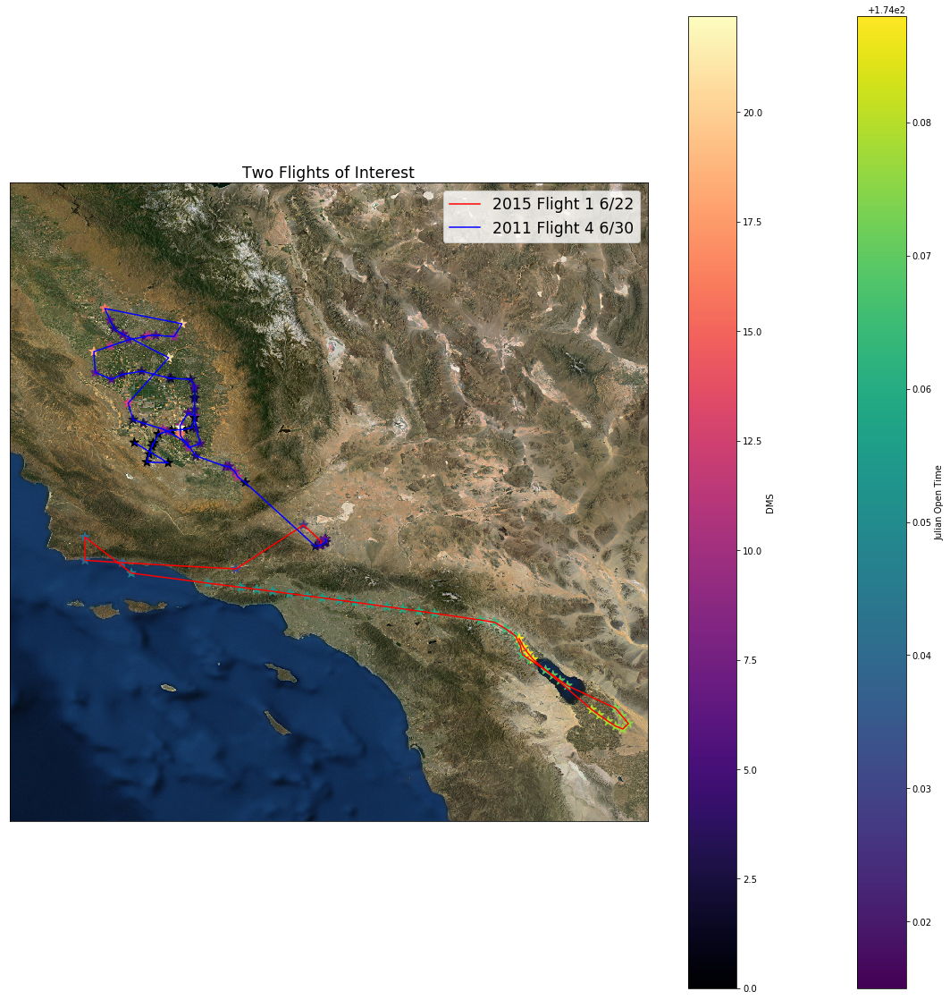

In [40]:
lats2015 = list(flight_1_2015['Latitude'])
lons2015 = list(flight_1_2015['Longitude'])

lats2011 = list(flight_4_2011['Latitude'])
lons2011 = list(flight_4_2011['Longitude'])

fig = plt.figure(figsize = (20, 20))
m = Basemap(projection='cyl', llcrnrlat=32, llcrnrlon=-121, urcrnrlat=38, urcrnrlon=-115)
x2015,y2015 = m(lons2015, lats2015)
x2011,y2011 = m(lons2011, lats2011)
#m.drawmapboundary(fill_color='#99ffff')
#m.fillcontinents(color='#cc9966',lake_color='#99ffff')
#m.bluemarble()
#m.drawlsmask(land_color='0.8', ocean_color='w', lsmask=None, lsmask_lons=None, lsmask_lats=None, lakes=True, resolution='l', grid=5)
#m.shadedrelief(scale=0.5)
m.arcgisimage(service='ESRI_Imagery_World_2D', xpixels = 2000, verbose= True)
#m.arcgisimage(service='ESRI_StreetMap_World_2D', xpixels = 2000, verbose= True)

plt.plot(x2015,y2015, color='red', label='2015 Flight 1 6/22')
plume2015 = plt.scatter(x2015,y2015,s=120, marker='*', c=flight_1_2015['Julian Open Time'], cmap='viridis')
plt.plot(x2011,y2011, color='blue',label='2011 Flight 4 6/30')
plume2011 = plt.scatter(x2011,y2011,s=120, marker='*', c=flight_4_2011['DMS (MS)'], cmap='magma')
#m.scatter?
#m.plot(x,y)

plt.title('Two Flights of Interest',fontsize='xx-large')
plt.legend(fontsize='xx-large')
cb2015 = plt.colorbar(plume2015, label = 'Julian Open Time')
cb2011 = plt.colorbar(plume2011, label = 'DMS')
plt.show()
#plt.savefig('bothflightsbytime.png', dpi=20)

In [83]:
ground = by_alt(full, 0, 1000)

http://server.arcgisonline.com/ArcGIS/rest/services/ESRI_Imagery_World_2D/MapServer/export?bbox=-121.0,32.0,-115.0,38.0&bboxSR=4326&imageSR=4326&size=2000,2000&dpi=96&format=png32&transparent=true&f=image


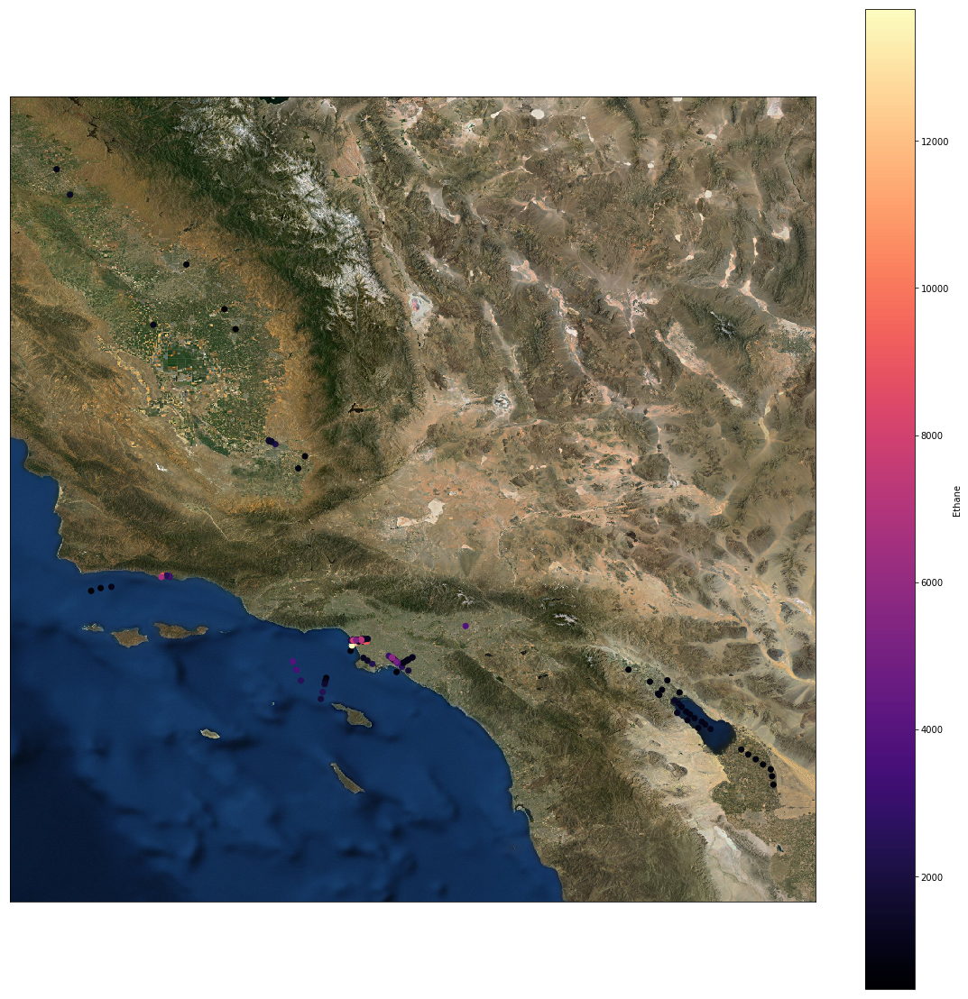

In [84]:
lats = list(ground['Latitude'])
lons = list(ground['Longitude'])
plt.figure(figsize = (20, 20))
m = Basemap(projection='cyl', llcrnrlat=32, llcrnrlon=-121, urcrnrlat=38, urcrnrlon=-115)
x,y = m(lons, lats)
#m.drawmapboundary(fill_color='#99ffff')
#m.fillcontinents(color='#cc9966',lake_color='#99ffff')
#m.bluemarble()
#m.drawlsmask(land_color='0.8', ocean_color='w', lsmask=None, lsmask_lons=None, lsmask_lats=None, lakes=True, resolution='l', grid=5)
#m.shadedrelief(scale=0.5)
m.arcgisimage(service='ESRI_Imagery_World_2D', xpixels = 2000, verbose= True)

WAS = plt.scatter(x,y, marker='o', c=ground['Ethane (E)'], cmap='magma')
cb = plt.colorbar(WAS, label = 'Ethane')
plt.show()
#plt.savefig('bothflights.png', dpi=20)

In [47]:
bl_low = by_alt(full, 3000, 5000)

http://server.arcgisonline.com/ArcGIS/rest/services/ESRI_Imagery_World_2D/MapServer/export?bbox=-122.0,32.0,-115.0,38.5&bboxSR=4326&imageSR=4326&size=2000,1857&dpi=96&format=png32&transparent=true&f=image


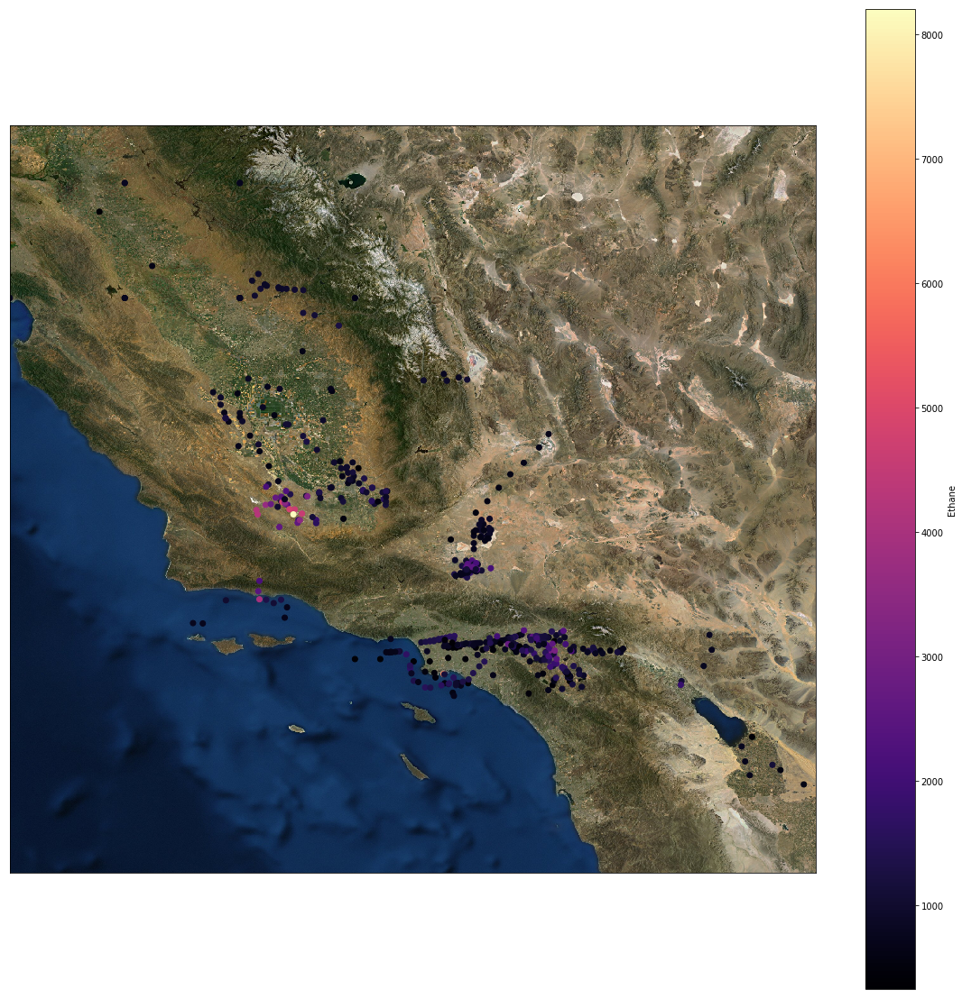

In [51]:
lats = list(bl_low['Latitude'])
lons = list(bl_low['Longitude'])
plt.figure(figsize = (20, 20))
m = Basemap(projection='cyl', llcrnrlat=32, llcrnrlon=-122, urcrnrlat=38.5, urcrnrlon=-115)
x,y = m(lons, lats)
#m.drawmapboundary(fill_color='#99ffff')
#m.fillcontinents(color='#cc9966',lake_color='#99ffff')
#m.bluemarble()
#m.drawlsmask(land_color='0.8', ocean_color='w', lsmask=None, lsmask_lons=None, lsmask_lats=None, lakes=True, resolution='l', grid=5)
#m.shadedrelief(scale=0.5)
m.arcgisimage(service='ESRI_Imagery_World_2D', xpixels = 2000, verbose= True)

WAS = plt.scatter(x,y, marker='o', c=bl_low['Ethane (E)'], cmap='magma')
cb = plt.colorbar(WAS, label = 'Ethane')
plt.show()
#plt.savefig('bothflights.png', dpi=20)

In [87]:
bl_high = by_alt(full, 5000, 10000)

http://server.arcgisonline.com/ArcGIS/rest/services/ESRI_Imagery_World_2D/MapServer/export?bbox=-121.0,32.0,-115.0,38.0&bboxSR=4326&imageSR=4326&size=2000,2000&dpi=96&format=png32&transparent=true&f=image


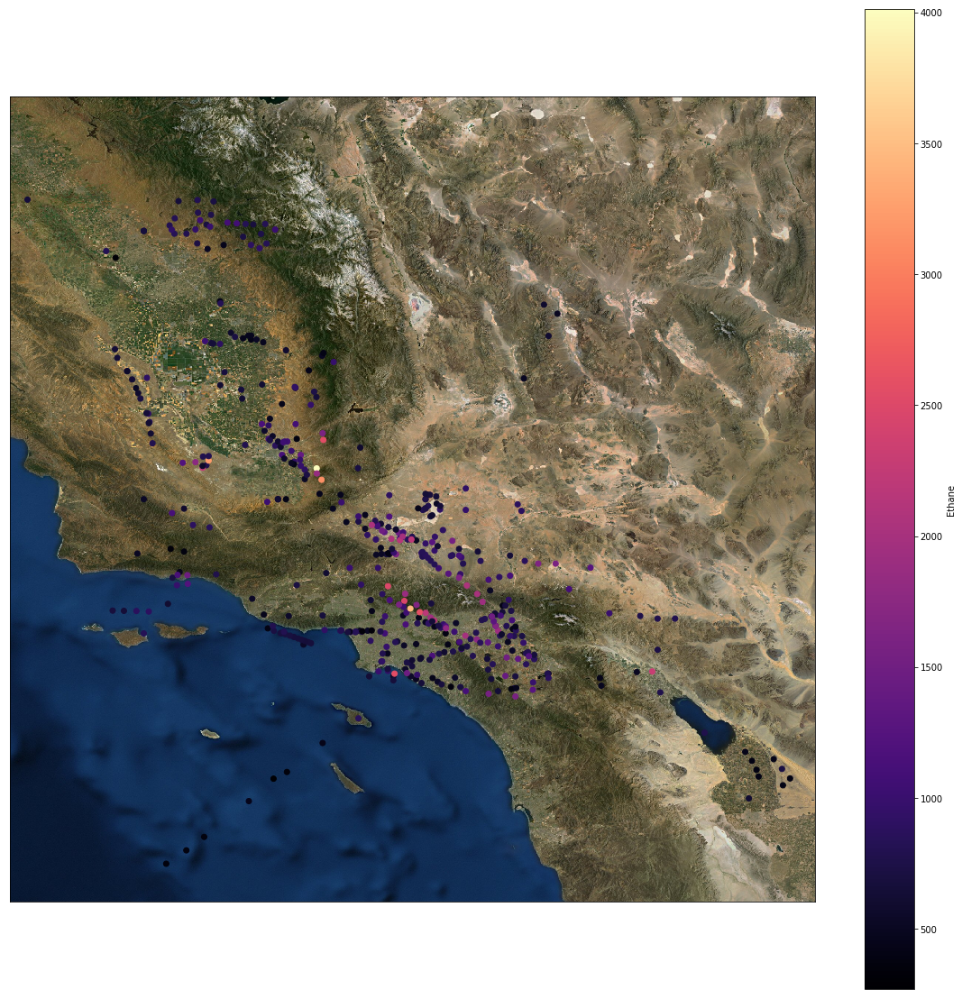

In [88]:
lats = list(bl_high['Latitude'])
lons = list(bl_high['Longitude'])
plt.figure(figsize = (20, 20))
m = Basemap(projection='cyl', llcrnrlat=32, llcrnrlon=-121, urcrnrlat=38, urcrnrlon=-115)
x,y = m(lons, lats)
#m.drawmapboundary(fill_color='#99ffff')
#m.fillcontinents(color='#cc9966',lake_color='#99ffff')
#m.bluemarble()
#m.drawlsmask(land_color='0.8', ocean_color='w', lsmask=None, lsmask_lons=None, lsmask_lats=None, lakes=True, resolution='l', grid=5)
#m.shadedrelief(scale=0.5)
m.arcgisimage(service='ESRI_Imagery_World_2D', xpixels = 2000, verbose= True)

WAS = plt.scatter(x,y, marker='o', c=bl_high['Ethane (E)'], cmap='magma')
cb = plt.colorbar(WAS, label = 'Ethane')
plt.show()
#plt.savefig('bothflights.png', dpi=20)

In [89]:
free_low = by_alt(full, 10000, 15000)

http://server.arcgisonline.com/ArcGIS/rest/services/ESRI_Imagery_World_2D/MapServer/export?bbox=-121.0,32.0,-115.0,38.0&bboxSR=4326&imageSR=4326&size=2000,2000&dpi=96&format=png32&transparent=true&f=image


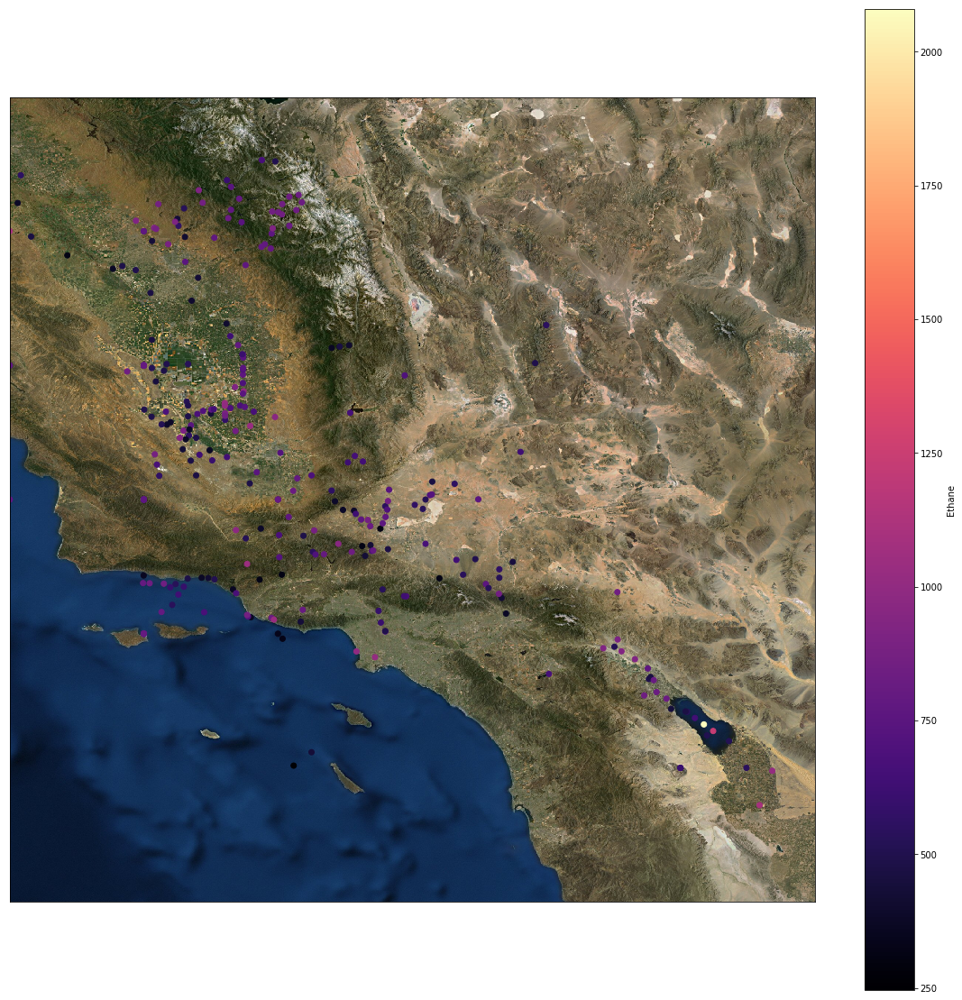

In [90]:
lats = list(free_low['Latitude'])
lons = list(free_low['Longitude'])
plt.figure(figsize = (20, 20))
m = Basemap(projection='cyl', llcrnrlat=32, llcrnrlon=-121, urcrnrlat=38, urcrnrlon=-115)
x,y = m(lons, lats)
#m.drawmapboundary(fill_color='#99ffff')
#m.fillcontinents(color='#cc9966',lake_color='#99ffff')
#m.bluemarble()
#m.drawlsmask(land_color='0.8', ocean_color='w', lsmask=None, lsmask_lons=None, lsmask_lats=None, lakes=True, resolution='l', grid=5)
#m.shadedrelief(scale=0.5)
m.arcgisimage(service='ESRI_Imagery_World_2D', xpixels = 2000, verbose= True)

WAS = plt.scatter(x,y, marker='o', c=free_low['Ethane (E)'], cmap='magma')
cb = plt.colorbar(WAS, label = 'Ethane')
plt.show()
#plt.savefig('bothflights.png', dpi=20)

In [91]:
free_high = by_alt(full, 15000, 30000)

http://server.arcgisonline.com/ArcGIS/rest/services/ESRI_Imagery_World_2D/MapServer/export?bbox=-121.0,32.0,-115.0,38.0&bboxSR=4326&imageSR=4326&size=2000,2000&dpi=96&format=png32&transparent=true&f=image


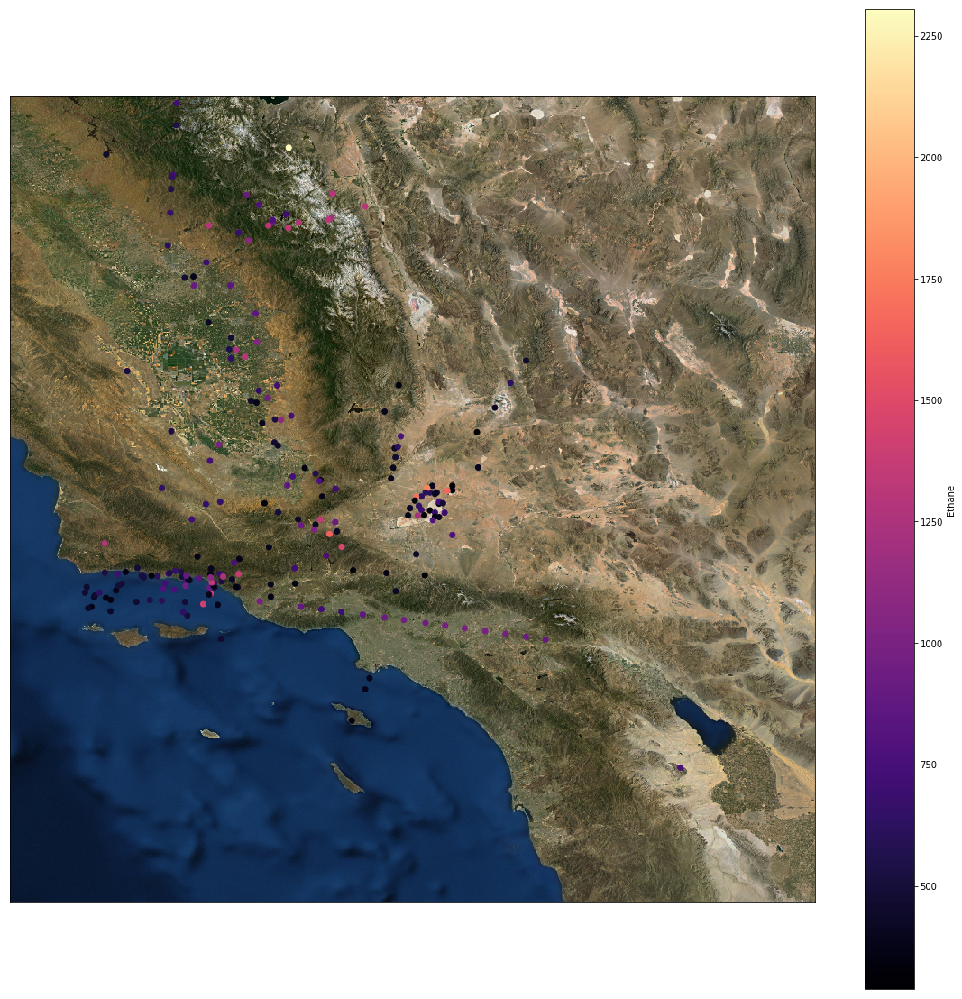

In [92]:
lats = list(free_high['Latitude'])
lons = list(free_high['Longitude'])
plt.figure(figsize = (20, 20))
m = Basemap(projection='cyl', llcrnrlat=32, llcrnrlon=-121, urcrnrlat=38, urcrnrlon=-115)
x,y = m(lons, lats)
#m.drawmapboundary(fill_color='#99ffff')
#m.fillcontinents(color='#cc9966',lake_color='#99ffff')
#m.bluemarble()
#m.drawlsmask(land_color='0.8', ocean_color='w', lsmask=None, lsmask_lons=None, lsmask_lats=None, lakes=True, resolution='l', grid=5)
#m.shadedrelief(scale=0.5)
m.arcgisimage(service='ESRI_Imagery_World_2D', xpixels = 2000, verbose= True)

WAS = plt.scatter(x,y, marker='o', c=free_high['Ethane (E)'], cmap='magma')
cb = plt.colorbar(WAS, label = 'Ethane')
plt.show()
#plt.savefig('bothflights.png', dpi=20)

In [58]:
def bmap(data, variable, minalt=0, maxalt=50000, cmap='magma', save=''):
    lats = list(data['Latitude'])
    lons = list(data['Longitude'])
    
    plt.figure(figsize = (20, 20))
    #m = Basemap(projection='cyl', llcrnrlat=min(lats)-0.2, llcrnrlon=min(lons)-0.2, urcrnrlat=max(lats)+0.2, urcrnrlon=max(lons)+0.2)
    m = Basemap(projection='cyl', llcrnrlat=32, llcrnrlon=-121, urcrnrlat=38, urcrnrlon=-115)
    x,y = m(lons, lats)
    m.arcgisimage(service='ESRI_Imagery_World_2D', xpixels = 2000, verbose= True)

    WAS = plt.scatter(x,y, marker='o', c=data[variable], cmap=cmap)
    cb = plt.colorbar(WAS, label = variable)
    plt.show()
    if save != '':
        plt.savefig(save, dpi=20)
    else:
        return

http://server.arcgisonline.com/ArcGIS/rest/services/ESRI_Imagery_World_2D/MapServer/export?bbox=-121.0,32.0,-115.0,38.0&bboxSR=4326&imageSR=4326&size=2000,2000&dpi=96&format=png32&transparent=true&f=image


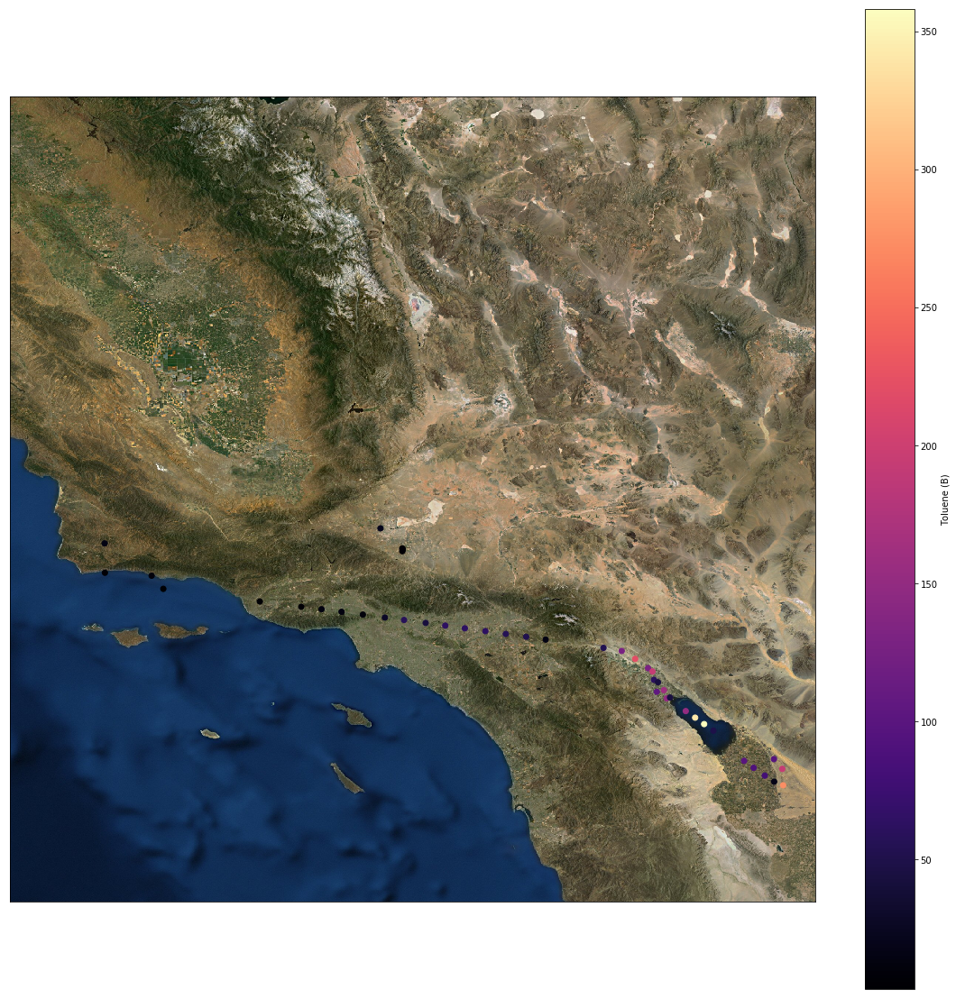

In [59]:
bmap(flight_1_2015, 'Toluene (B)')

In [60]:
def bmap_gif(data, variable, minalt=0, maxalt=50000, cmap='magma', save=''):
    
    lats = list(data['Latitude'])
    lons = list(data['Longitude'])
    fig = plt.figure(figsize = (20, 20))
    m = Basemap(projection='cyl', llcrnrlat=32, llcrnrlon=-121, urcrnrlat=38, urcrnrlon=-115)
    x,y = m(lons, lats)
    m.arcgisimage(service='ESRI_Imagery_World_2D', xpixels = 2000, verbose= True)
    WAS = plt.scatter(x,y, marker='o', c=data[variable], cmap=cmap)
    cb = plt.colorbar(WAS, label = variable)
    return fig
    plt.show()
    if save != '':
        plt.savefig(save, dpi=20)
    else:
        return
    
    lats = list(data['Latitude'])
    lons = list(data['Longitude'])
    fig = plt.figure(figsize = (20, 20))
    
    def init():
        m = Basemap(projection='cyl', llcrnrlat=32, llcrnrlon=-121, urcrnrlat=38, urcrnrlon=-115)
        x,y = m(lons, lats)
        m.arcgisimage(service='ESRI_Imagery_World_2D', xpixels = 2000, verbose= True)
        WAS = plt.scatter(x,y, marker='o', c=data[variable], cmap=cmap)
        cb = plt.colorbar(WAS, label = variable)
        return fig
    
    init = init()

    def rotate(angle):
        ax.view_init(azim=angle)
        return fig
    angle=3

    anim = animation.FuncAnimation(fig, rotate, frames=np.arange(0, 360, angle), interval=50)

    anim.save(filename, writer='ffmpeg', fps=10)